# Plant disease multi-classification

Dataset from Kaggle: https://www.kaggle.com/datasets/tushar5harma/plant-village-dataset-updated/code

## Problem
Identifing plant diseases from images

Transfer learning wit: https://www.kaggle.com/models/google/resnet-v2


In [ ]:
# Unzip data into googleDrive
#!unzip "/content/drive/MyDrive/programming/plant_village/01_data/plant_village_dataset.zip" -d "/content/drive/MyDrive/programming/plant_village/01_data/"

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import tensorflow as tf
import tensorflow_hub as hub

In [2]:
print(tf.__version__, hub.__version__)

2.15.0 0.16.1


We have the unziped images. They are stored in the directory `01_data`. Now we look at the folderstructure:
1. Folders with names of the Plant
2. Folders with test, train and validation sets
3. Folders with names of diseases or healthy plants
4. images

Now we hav to use this information to create a classification target list. We have to classify the:
* Plantname and
* Disease type (healthy)

In [3]:
# get the names of the plants
data_path = '/content/drive/MyDrive/programming/plant_village/01_data/'
plant_names = os.listdir(data_path)
plant_names

['Apple',
 'Bell Pepper',
 'Cherry',
 'Corn (Maize)',
 'Grape',
 'Peach',
 'Potato',
 'Strawberry',
 'Tomato']

In [4]:
# Itterate over all folders to get the names of the Plants, the disease and the image ID from training data.
def get_data(data_type):
  '''
  Get's train, test or valuation set data set names from folders with plantnames, disease names and image ids from folders
  '''
  data = []

  for plant in plant_names:
      disease_names = os.listdir(data_path + plant + '/' + data_type + '/')
      for disease in disease_names:
          image_ids = os.listdir(data_path + plant + '/' + data_type + '/' + disease + "/")
          for image_id in image_ids:
              plant_data = {'plant': plant, 'disease': disease, 'id': image_id}
              data.append(plant_data)
  return data

In [5]:
train_df = pd.DataFrame(get_data('Train'))
test_df = pd.DataFrame(get_data('Test'))
val_df = pd.DataFrame(get_data('Val'))

In [ ]:
test_df

,plant,disease,id
0,Apple,Apple Scab,d08d117d-d394-4e24-83c2-cd7fd96894ce___FREC_Sc...
1,Apple,Apple Scab,774fb249-80b5-4575-ab5a-5459a9c14ef6___FREC_Sc...
2,Apple,Apple Scab,d608ac35-eaf8-43e2-b429-f9b433126023___FREC_Sc...
3,Apple,Apple Scab,b18d07ee-d2e2-4cc2-876c-e03e3839f3b6___FREC_Sc...
4,Apple,Apple Scab,c745cec0-6c89-4bee-b0c2-a71a925b7f1b___FREC_Sc...
...,...,...,...
1349,Tomato,Yellow Leaf Curl Virus,b3fe3d8c-f0e0-405c-a67d-ac57db6be043___YLCV_GC...
1350,Tomato,Yellow Leaf Curl Virus,b0c0a1fb-0597-4ca1-99e4-6cea1804e633___YLCV_NR...
1351,Tomato,Yellow Leaf Curl Virus,dd9b2bbb-6708-4188-8224-1bbf75c9f55b___UF.GRC_...
1352,Tomato,Yellow Leaf Curl Virus,e7793d98-ca6c-4030-8b4a-4bd506cde757___YLCV_NR...


In [ ]:
len(train_df)

50156

<Axes: >

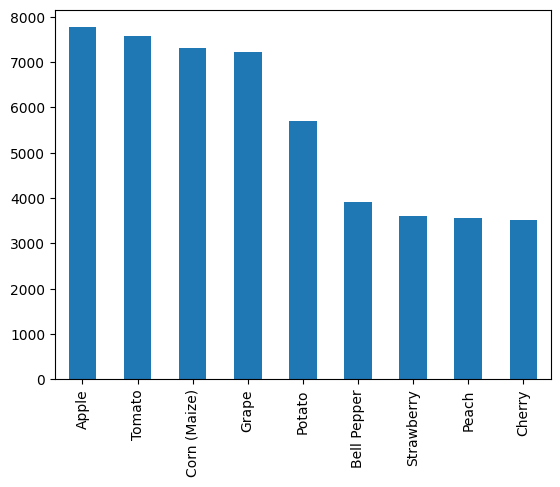

In [ ]:
# How many images are there of each plant?
train_df['plant'].value_counts().plot.bar()

<Axes: xlabel='plant,disease'>

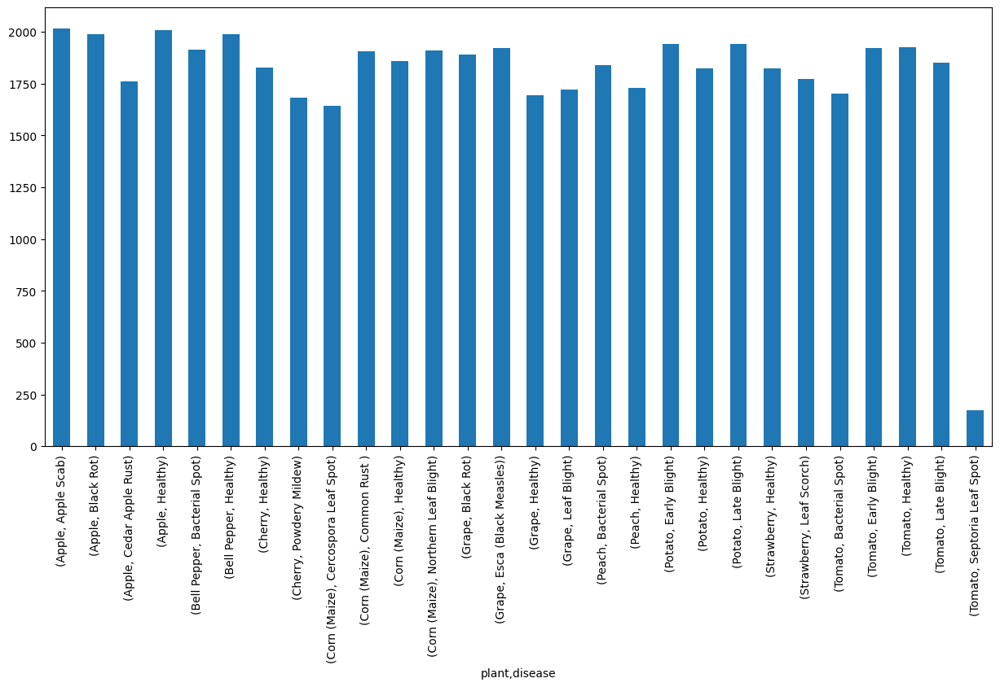

In [ ]:
# How many images are there of each disease? We can't look at healthy, for those are for all plants.
train_grouped = train_df.groupby(["plant", "disease"]).size()
train_grouped.plot.bar(figsize=(15, 7))

In [6]:
# cunstruct the target in the dataframe by concatenate plant and diseas in its own colum for classifiactaion
train_df['plant_disease'] = train_df['plant'] + " " + train_df['disease']
val_df['plant_disease'] = val_df['plant'] + " " + val_df['disease']
val_df

,plant,disease,id,plant_disease
0,Apple,Apple Scab,0261a6e4-21f8-481a-8827-b674e6955644___FREC_Sc...,Apple Apple Scab
1,Apple,Apple Scab,0537ad56-3d24-4e97-a947-65b9b37f8988___FREC_Sc...,Apple Apple Scab
2,Apple,Apple Scab,023123cb-7b69-4c9f-a521-766d7c8543bb___FREC_Sc...,Apple Apple Scab
3,Apple,Apple Scab,00075aa8-d81a-4184-8541-b692b78d398a___FREC_Sc...,Apple Apple Scab
4,Apple,Apple Scab,0261a6e4-21f8-481a-8827-b674e6955644___FREC_Sc...,Apple Apple Scab
...,...,...,...,...
9567,Strawberry,Leaf Scorch,f740e529-abd0-44e1-898e-92ee5afa16f1___RS_L.Sc...,Strawberry Leaf Scorch
9568,Strawberry,Leaf Scorch,5d1b08e5-92d8-4d4d-9a1b-ba8b92fc1d9a___RS_L.Sc...,Strawberry Leaf Scorch
9569,Strawberry,Leaf Scorch,443c9ee2-4656-4752-bab8-650c4cd03d0a___RS_L.Sc...,Strawberry Leaf Scorch
9570,Strawberry,Leaf Scorch,815aa30d-7b13-4f1b-8fd6-eae08e7b88e6___RS_L.Sc...,Strawberry Leaf Scorch


In [7]:
labels_train = train_df['plant_disease'].to_numpy()
labels_val = val_df['plant_disease'].to_numpy()
labels_train

array(['Apple Apple Scab', 'Apple Apple Scab', 'Apple Apple Scab', ...,
       'Tomato Septoria Leaf Spot', 'Tomato Septoria Leaf Spot',
       'Tomato Septoria Leaf Spot'], dtype=object)

In [8]:
unique_disease = np.unique(labels_train)
unique_disease

array(['Apple Apple Scab', 'Apple Black Rot', 'Apple Cedar Apple Rust',
       'Apple Healthy', 'Bell Pepper Bacterial Spot',
       'Bell Pepper Healthy', 'Cherry Healthy', 'Cherry Powdery Mildew',
       'Corn (Maize) Cercospora Leaf Spot', 'Corn (Maize) Common Rust ',
       'Corn (Maize) Healthy', 'Corn (Maize) Northern Leaf Blight',
       'Grape Black Rot', 'Grape Esca (Black Measles)', 'Grape Healthy',
       'Grape Leaf Blight', 'Peach Bacterial Spot', 'Peach Healthy',
       'Potato Early Blight', 'Potato Healthy', 'Potato Late Blight',
       'Strawberry Healthy', 'Strawberry Leaf Scorch',
       'Tomato Bacterial Spot', 'Tomato Early Blight', 'Tomato Healthy',
       'Tomato Late Blight', 'Tomato Septoria Leaf Spot'], dtype=object)

In [ ]:
len(unique_disease)

28

In [9]:
# Turn a single label into an array of booleans
print(labels_train[12056])
labels_train[12056] == unique_disease

Cherry Healthy


array([False, False, False, False, False, False,  True, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False])

In [10]:
# Turn every label into a boolean array
boolean_labels_train = [label == unique_disease for label in labels_train]
boolean_labels_val = [label == unique_disease for label in labels_val]
boolean_labels_val[:2]

[array([ True, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False]),
 array([ True, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False])]

In [ ]:
len(boolean_labels_train), len(boolean_labels_val)

(50156, 9572)

## Making the X_train, y_train, X_val, y_val and X_test

In [11]:
X_train = list(data_path + train_df['plant'] + '/Train/' + train_df['disease'] + '/' + train_df['id'])
y_train = boolean_labels_train
X_val = list(data_path + val_df['plant'] + '/Val/' + val_df['disease'] + '/' + val_df['id'])
y_val = boolean_labels_val
X_test = list(data_path + test_df['plant'] + '/Test/' + test_df['disease'] + '/' + test_df['id'])

In [ ]:
# Let's have a geez at the training data
X_train[:5], y_train[:2]

(['/content/drive/MyDrive/programming/plant_village/01_data/Apple/Train/Apple Scab/51530f6a-2bee-4008-8e77-eeda281e9195___FREC_Scab 3209.JPG',
  '/content/drive/MyDrive/programming/plant_village/01_data/Apple/Train/Apple Scab/66fab3e4-d6e3-4a6d-aff0-4fe011ef8eb3___FREC_Scab 3153_270deg.JPG',
  '/content/drive/MyDrive/programming/plant_village/01_data/Apple/Train/Apple Scab/0c620ec5-11cf-4120-94ab-1311e99df147___FREC_Scab 3131_new30degFlipLR.JPG',
  '/content/drive/MyDrive/programming/plant_village/01_data/Apple/Train/Apple Scab/5990ed9f-ffe8-4622-bd26-e536ea5e1109___FREC_Scab 3042_new30degFlipLR.JPG',
  '/content/drive/MyDrive/programming/plant_village/01_data/Apple/Train/Apple Scab/474cf33e-0289-4014-bb8a-8004b87b471b___FREC_Scab 3425_90deg.JPG'],
 [array([ True, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False]),
  array

## Preprocessing images (turning images into Tensors)

To preprocess our images into Tensors we're going to write a function wich does a few things:

1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable image
3. Turn image(a jpg) into Tensors
4. Normalize our image (convert color channel values from 0-255 to 0-1)
5. Resize the image to be shape of (224, 224)
6. Return the modified image


In [12]:
# convert image to numpy array
from matplotlib.pyplot import imread
image = imread(X_train[42])
image.shape

(256, 256, 3)

In [ ]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 256, 3), dtype=uint8, numpy=
array([[[ 41,  47,  81],
        [ 40,  46,  80],
        [ 40,  46,  80],
        ...,
        [150, 143, 174],
        [148, 141, 172],
        [134, 127, 158]],

       [[ 43,  49,  83],
        [ 42,  48,  82],
        [ 41,  47,  81],
        ...,
        [164, 157, 188],
        [148, 141, 172],
        [115, 108, 139]]], dtype=uint8)>

In [13]:
# make function to preprocess
# Define image size
IMG_SIZE = 224

def process_image(image_path, img_size=IMG_SIZE):
  '''
  Takes an image filepath and turns the image into a Tensor.
  '''
  # Read in an image file
  image = tf.io.read_file(image_path)
  # Turn the jpg image into numerical Tensor with 3 color channels (R;G;B)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel value from 0-255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired value (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image

 ## Turning our data into batches

Why turn our data into batches?

Let's say you're trying to process 10,000+ images in one go... they all might not fit into memory.

So that's why we do about 32 images at a time (batch size 32).

In order to use TF effectively, we need our data in the form of Tensor tuples wich look like this:
`(image, label)`.

In [14]:
# create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  '''
  Takes an image file path name and the associated label, processes the image and returns a tuple of (image, label).
  '''
  image = process_image(image_path)
  return image, label

In [ ]:
get_image_label(X_train[42], y_train[42])

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.16080433, 0.18433374, 0.31766707],
         [0.15652262, 0.18005203, 0.31338537],
         [0.15312125, 0.17665066, 0.309984  ],
         ...,
         [0.622288  , 0.5987586 , 0.7085625 ],
         [0.5797718 , 0.5562424 , 0.6660463 ],
         [0.52392864, 0.50039923, 0.61020315]],
 
        [[0.16554622, 0.18907565, 0.32240897],
         [0.16386555, 0.18739498, 0.3207283 ],
         [0.15630253, 0.17983194, 0.31316528],
         ...,
         [0.61098427, 0.58745486, 0.6972588 ],
         [0.5758101 , 0.55228066, 0.6620846 ],
         [0.4673451 , 0.44381568, 0.5536196 ]],
 
        [[0.16582634, 0.18935576, 0.3226891 ],
         [0.1647459 , 0.18827532, 0.32160866],
         [0.15938376, 0.18291317, 0.3162465 ],
         ...,
         [0.47999182, 0.4564624 , 0.5662663 ],
         [0.46986791, 0.4463385 , 0.55614245],
         [0.53835666, 0.51482725, 0.62463117]],
 
        ...,
 
        [[0.5296516 , 0.49827904

Noew we've got a way to turn our data into tuples of tensores
in the form: `(image, label)`, let's make a function to turn all of our data (x & y) into batches!

In [15]:
# Define the batch size, 32 is a good start
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  '''
  Creates batches of data out if image (X) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle if it's validation data.
  Also accepts test data as input (no labels)
  '''
  # If the data is a test dataset, we probably don't have have labels
  if test_data:
    print('Creating test data batches...')
    data = tf.data.Dataset.from_tensor_slices(tf.constant(X)) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(batch_size)
    return data_batch

  # If the Data is a vlaid dataset, we don't need to shuffle it
  elif valid_data:
    print('Creating validation data batches...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),  # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(batch_size)
    return data_batch

  else:
    print('Creating trining data batches...')
    # Turn filepaths an labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                               tf.constant(y)))
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(X))

    # Create (image, label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the training data into batches
    data_batch = data.batch(batch_size)

  return data_batch

In [16]:
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating trining data batches...
Creating validation data batches...


In [ ]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 28), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 28), dtype=tf.bool, name=None)))

## Visualizing Data Batches

our data is now in batches, however, these can be a little hard to understadn/comprehend, let's visualize them!

In [ ]:
# create a function for viewing images in a data batch
def show_25_images(images, labels):
  '''
  Displays a plot of 25 images and their labels from a data batch
  '''
  # Setup the figure
  plt.figure(figsize=(15, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_disease[labels[i].argmax()])
    # Turn the gridlines off
    plt.axis('off')

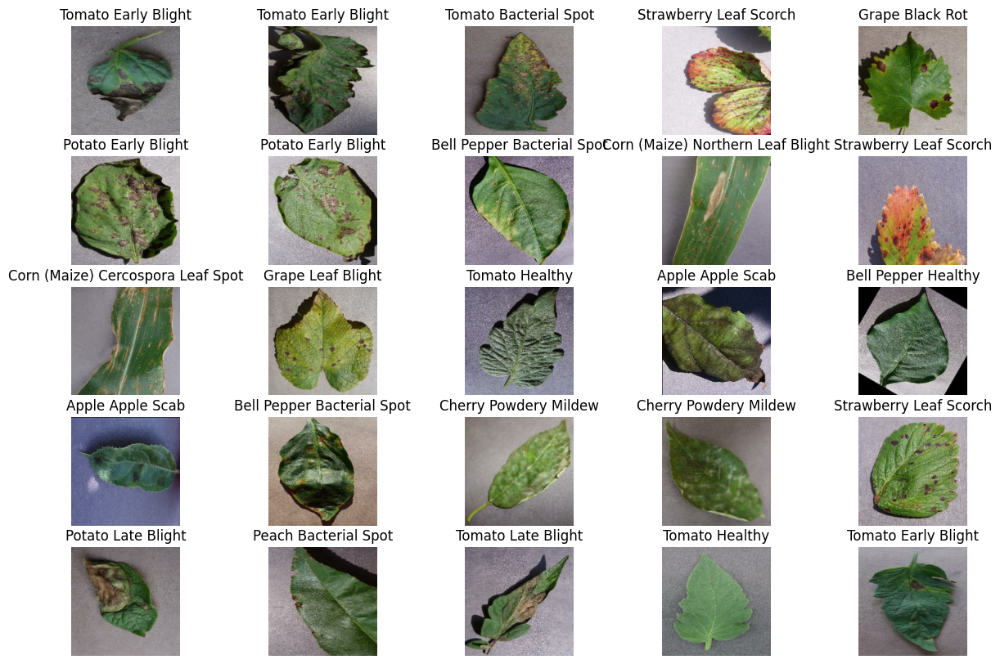

In [ ]:
# Now let's visualize data in a batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

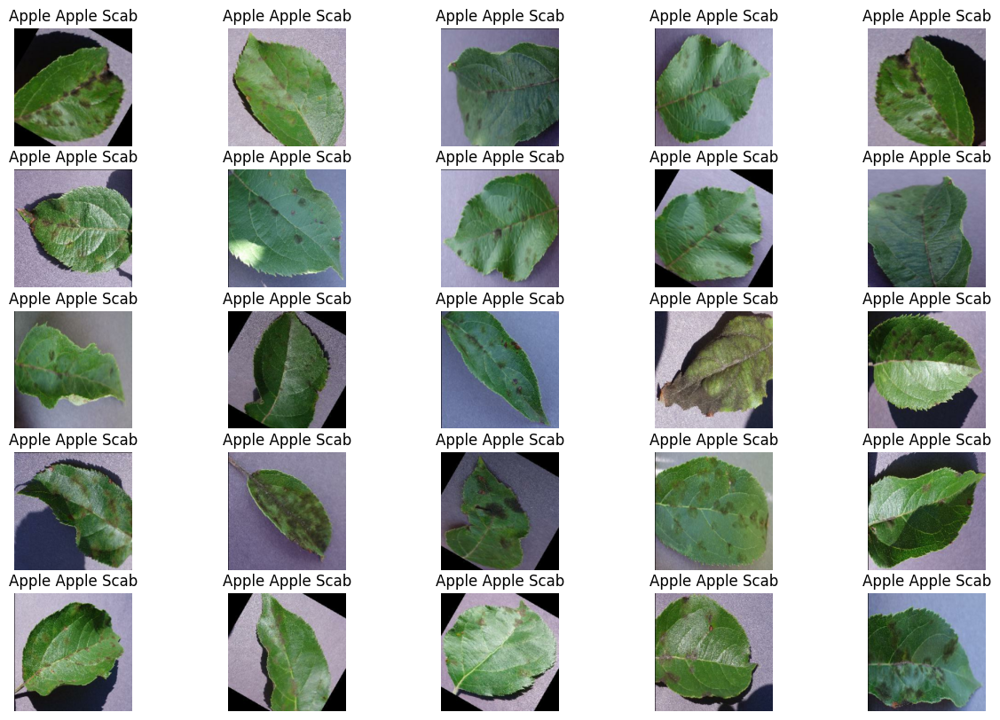

In [ ]:
# Now let's visualize val data in a batch
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Building a model

Before we build a model, there are a few thing we need to define:
* The input shape (our image shape, in the form of Tensors) to our model.
* The output shape (image labels, in the form of Tensors) of our model.
* The URL of the model we want to use from TensorFlow Hub (https://www.kaggle.com/models/google/resnet-v2).



In [ ]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of our model
OUTPUT_SHAPE = len(unique_disease)

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://www.kaggle.com/models/google/resnet-v2/frameworks/TensorFlow2/variations/101-classification/versions/2"

Now we've got our inputs, output and model ready to got.
Let's put them together into Keras deep learning model!

Knowing this, let's create a function wich:
* Takes the input shape, output shape and the model we've chosen as parameters
* Defines the layers in a Keras model in sequential fashion (do this first, then this, then that)
* Compiles the model (says it should be evaluated an improved).
* Build the model (tells the model the input shap it'll be getting)
* Return the model.

All of these Steps can be found here: https://www.tensorflow.org/guide/keras

In [ ]:
# Create a function wich builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print('Building model with:', model_url)

  # Setup the model layers
  model = tf.keras.Sequential([
      hub.KerasLayer(model_url), # Layer 1 (input layer)
      tf.keras.layers.Dense(units=output_shape,
                            activation='softmax') # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalFocalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=['accuracy']
  )

  # Build the model
  model.build(input_shape)

  return model

In [ ]:
model = create_model()
model.summary()

Building model with: https://www.kaggle.com/models/google/resnet-v2/frameworks/TensorFlow2/variations/101-classification/versions/2
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_8 (KerasLayer)  (None, 1001)              44677609  
                                                                 
 dense_8 (Dense)             (None, 28)                28056     
                                                                 
Total params: 44705665 (170.54 MB)
Trainable params: 28056 (109.59 KB)
Non-trainable params: 44677609 (170.43 MB)
_________________________________________________________________


## Creating callbacks

Callbacks are hlper functions a model can use during training to such things as save its progress, check its progress or stop training early if a model stops improving

We'll creat two callback, one for TensorBoard which helps track our models progress and another for early stopping which prevent our model from training for to long.

### TesnorBoard Callback

To setup a TensorBoard callback, we need to do 3 things:
1. Load the TensorBoard notbook extension ✅
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function.✅
3. Visualize our models training logs with the `%tensorboard` magic function (we'll do this after model training).

In [ ]:
# Load TensorBoard notebook extension
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
import datetime

# Create a function to build a TesorBoard callback
def create_tensorboard_callback():
  # Creat a log directory for storing TensorBoard logs
  logdir = os.path.join('/content/drive/MyDrive/programming/plant_village/logs',
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime('%Y%m%d-%H%M%S'))
  return tf.keras.callbacks.TensorBoard(logdir)

### Early stopping callback

Helsp stopping our model from overfitting by stopping training if a certain evaluation metric stops improving

In [ ]:
# Creating early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                                  patience=3)


## Checkpoint callback

In [ ]:
checkpoint_cb = tf.keras.callbacks.ModelCheckpoint('/content/drive/MyDrive/programming/plant_village/logs/model_cb.h5',
                                                   save_best_only=True)

## Training a model (on a subset of data)

Our first model is only going to train on 1000 images, to make sure everything is working.

In [ ]:
NUM_EPOCHS = 100 #@param {type:'slider', min:10, max:100, step:10}

Let's create a function which trains our model.

* Create a model using `creat_model()`
* Setup a TensorBoard callback using `create_tensorboard_callback()`
* Call the `fit()` function on our model passing it the training data, validation data, number of epochs to train for (`NUM_EPOCHS`) and the callbacks we'd like to use
* Return the model

In [ ]:
# Build a function to train and return a trained model
def train_model():
  '''
  Trains a given model and returns the trained version.
  '''
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq =1,
            callbacks=[tensorboard, early_stopping, checkpoint_cb])
  # Return the fitted model
  return model

In [ ]:
# Fit our model to the data
model = train_model()

Building model with: https://www.kaggle.com/models/google/resnet-v2/frameworks/TensorFlow2/variations/101-classification/versions/2
Epoch 1/100
1568/1568 [==============================] - ETA: 0s - loss: 0.0611 - accuracy: 0.8750

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1568/1568 [==============================] - 8980s 6s/step - loss: 0.0611 - accuracy: 0.8750 - val_loss: 0.0205 - val_accuracy: 0.9475
Epoch 2/100
1568/1568 [==============================] - 330s 210ms/step - loss: 0.0261 - accuracy: 0.9355 - val_loss: 0.0300 - val_accuracy: 0.9358
Epoch 3/100
1568/1568 [==============================] - 328s 209ms/step - loss: 0.0228 - accuracy: 0.9455 - val_loss: 0.0259 - val_accuracy: 0.9417
Epoch 4/100
1568/1568 [==============================] - 329s 209ms/step - loss: 0.0206 - accuracy: 0.9518 - val_loss: 0.0330 - val_accuracy: 0.9373


In [ ]:
# Create a function to save a model
def save_model(model, suffix=None):
  '''
  Saves a given model in a models directory and appends a suffix (string)
  '''
  # Create a model directory pathname with current time
  modeldir = os.path.join("/content/drive/MyDrive/programming/plant_village/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [17]:
# Create a function to load a trained model
def load_model(model_path):
  '''
  Loads a saved model from a specified path
  '''
  print(f"Loading saved model from {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# Save our model trained on 1000 images
save_model(model, suffix="all-images-ResNetv2-Adam")

Saving model to: /content/drive/MyDrive/programming/plant_village/models/20240316-145843-all-images-ResNetv2-Adam.h5...


'/content/drive/MyDrive/programming/plant_village/models/20240316-145843-all-images-ResNetv2-Adam.h5'

In [18]:
# Load a trained model
loaded_image_model = load_model("/content/drive/MyDrive/programming/plant_village/models/20240316-145843-all-images-ResNetv2-Adam.h5")

Loading saved model from /content/drive/MyDrive/programming/plant_village/models/20240316-145843-all-images-ResNetv2-Adam.h5


In [ ]:
tf.__version__

'2.15.0'

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/programming/plant_village/logs

Output hidden; open in https://colab.research.google.com to view.

## Making and evaluating predictions using a trained model

In [19]:
test_data = create_data_batches(X_test, test_data=True)

Creating test data batches...


In [20]:
# Make prediction on the test data (not used to train on)
predictions = loaded_image_model.predict(test_data, verbose=1)
predictions

43/43 [==============================] - 282s 6s/step


array([[9.2246330e-01, 2.0178195e-06, 3.8280688e-02, ..., 1.8088533e-04,
        6.9362228e-04, 5.1286188e-04],
       [9.8470128e-01, 4.0436898e-08, 4.3461907e-05, ..., 6.9936817e-08,
        9.2007849e-06, 8.3510940e-08],
       [9.9374628e-01, 1.0679835e-09, 8.3558416e-06, ..., 1.0763043e-09,
        1.3938214e-04, 2.6175858e-06],
       ...,
       [2.0542297e-10, 3.5498942e-16, 4.4428374e-11, ..., 1.2832940e-05,
        2.4452596e-03, 4.3701638e-07],
       [2.1564204e-12, 2.0828572e-14, 6.7896047e-14, ..., 2.3040084e-11,
        7.6091640e-02, 3.6388028e-02],
       [1.3569796e-09, 1.3001274e-13, 1.5618902e-11, ..., 1.1939356e-03,
        1.0168779e-01, 5.4388631e-05]], dtype=float32)

Having the above functionality is great but we want to be able to do it a scale.

And it would be even better if we could see the image the prediction is being made on!

**Note:** Prediction probabilities are also known as confidence levels.

In [23]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  '''
  Turns an array of prediction probabilities into a label.
  '''
  return unique_disease[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[81])
pred_label

'Apple Black Rot'

Now since our validation data is still in a batch dataset, we'll have to unbach it to make prediction on the validation images and then compare those predictions to the validation labels (truth labels)

In [27]:
# Create a function to unbatch a batch dataset
def unbachify(data):
  '''
  Takes a batched dataset of (image, label) Tensors and returns seperate arrays of images and labels.
  '''
  images = []
  labels = []

  # Loop through unbatched data
  for image, label in val_data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_disease[np.argmax(label)])
  return images, labels

# Unbachify the validation data
val_images, val_labels = unbachify(val_data)
val_images[0], val_labels[0]

(array([[[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],
 
        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],
 
        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],
 
        ...,
 
        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],
 
        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],
 
        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]]], dtype=float32),
 'Apple Apple Scab')

Now we'we got ways to get:
* Prediction labels
* Validation labes (truth labels)
* Validation images

Let's make some function to make all a bit more visualize.

We'll creat a function which:
* Takes an array of prediction probabilities, an array of truth labels and an array of images and an integer
* Convert the prediction probabilities to a predicted label.
* Plot the predicted label, its predicted probability, the truth label and the target image on a single plot.

In [28]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  '''
  View the prediction, ground truth and image for sample n
  '''
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the colour of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  # Change plot title to be predicted, probability of prediction and truth label
  plt.title('{} {:2.0f}% {}'.format(pred_label,
                                    np.max(pred_prob)*100,
                                    true_label),
            color=color)

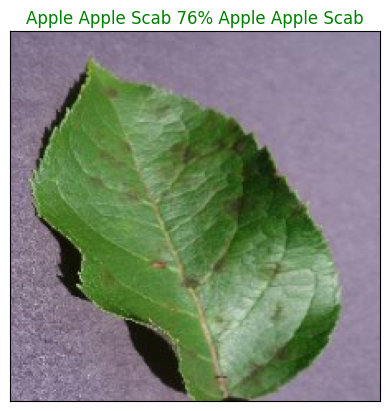

In [30]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=41)

Now we've got one function to visualize our models top prediction, let's make another to view our models top 10 prediction.

This function will:
* Take an input of prediction probabilities arra and a ground truth array and an integer
* Find the prediction using `get_pred_label()`
* Find top 10:
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels
* Plot the top 10 prediction probability values and labels, coloring the true label green

In [34]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  '''
  Plot the top 10 highest prediction confidences along with the truth label for sample n.
  '''

  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # FInd the top 10 prediction labels
  top_10_pred_labels = unique_disease[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

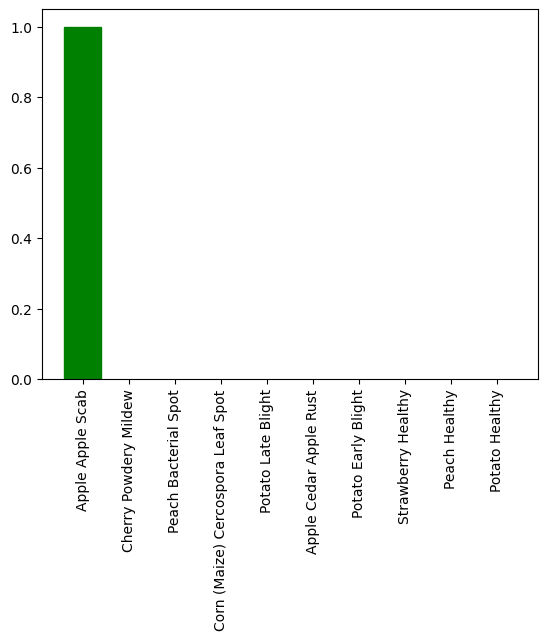

In [35]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

Now we've got some function to help us visualize our predictions and evaluate our modle,  let's check out a few.

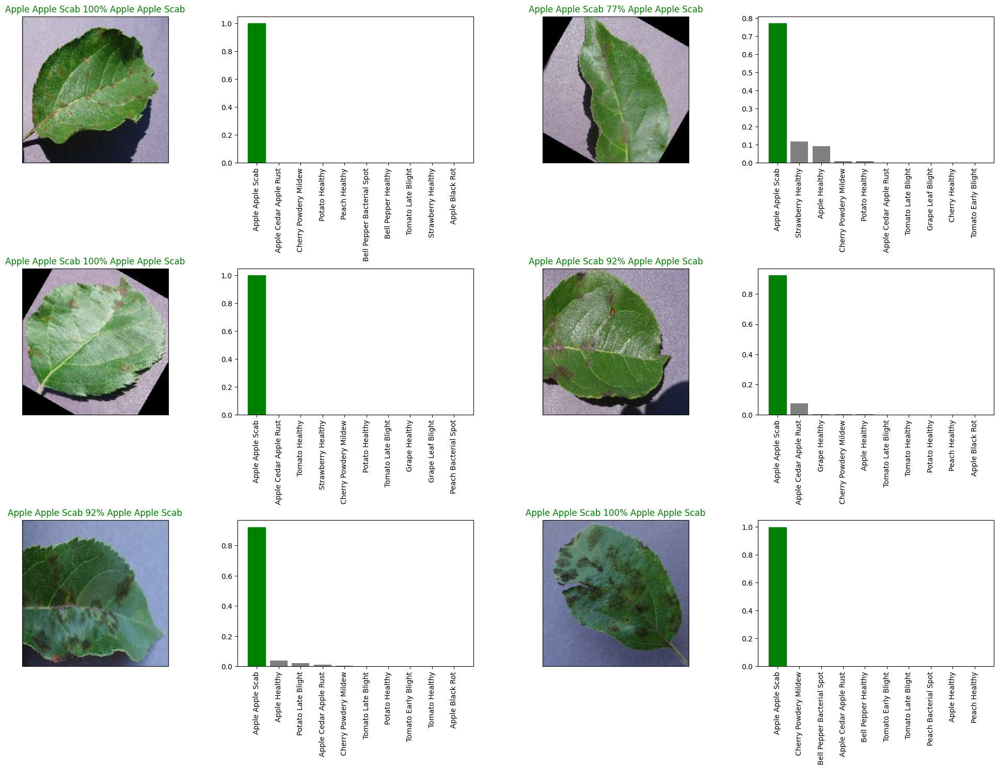

In [36]:
# Let's chack out a few predictions and their different values
i_multiplier = 20
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels=val_labels,
                 n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

In [38]:
np.savetxt("/content/drive/MyDrive/programming/plant_village/preds_array.csv", predictions, delimiter=",")

In [39]:
predictions = np.loadtxt("/content/drive/MyDrive/programming/Dog-vision/preds_array.csv", delimiter=",")

In [40]:
loaded_image_model.evaluate(val_data)

300/300 [==============================] - 53s 163ms/step - loss: 0.0330 - accuracy: 0.9373


[0.03295837342739105, 0.9373171925544739]

In [41]:
# Get custom image filepaths
custom_path = "/content/drive/MyDrive/programming/plant_village/my_photos/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [42]:
custom_image_paths

['/content/drive/MyDrive/programming/plant_village/my_photos/potato-plant-infected-late-blight.jpg',
 '/content/drive/MyDrive/programming/plant_village/my_photos/UNADJUSTEDNONRAW_thumb_56d0.jpg',
 '/content/drive/MyDrive/programming/plant_village/my_photos/eFcc7bbLeP5JzqcP2nGwLU.jpg',
 '/content/drive/MyDrive/programming/plant_village/my_photos/Example-of-healthya-and-infectedb-corn-leaves-for-classification-and-disease.jpg',
 '/content/drive/MyDrive/programming/plant_village/my_photos/bda-esca3.jpeg',
 '/content/drive/MyDrive/programming/plant_village/my_photos/omafra-black-rot-figure-1-en-400x308-2022-07-21-v1.jpg']

In [43]:
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Creating test data batches...


<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [44]:
# Make predictions on the custom data
custom_preds = loaded_image_model.predict(custom_data,
                                             verbose=1)

1/1 [==============================] - 3s 3s/step


In [45]:
custom_preds.shape

(6, 28)

In [46]:
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['Potato Late Blight',
 'Bell Pepper Bacterial Spot',
 'Bell Pepper Bacterial Spot',
 'Corn (Maize) Healthy',
 'Grape Esca (Black Measles)',
 'Grape Black Rot']

In [47]:
# Get custom images (our unbatchify() function won't work since there aren't labels... maybe we could fix this later)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

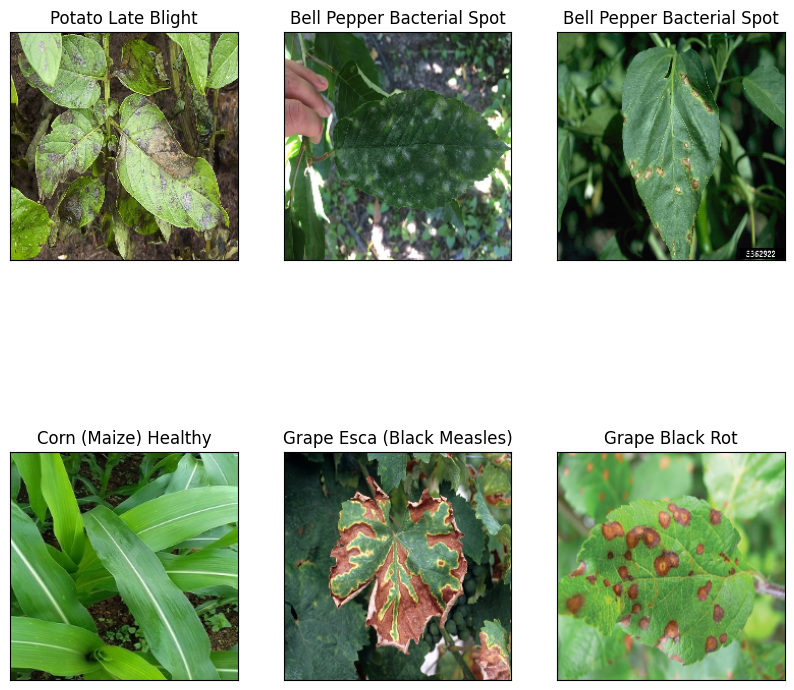

In [48]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(2, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)